In [2]:
import geopandas as gpd
import os
import pandas as pd

<AxesSubplot: >

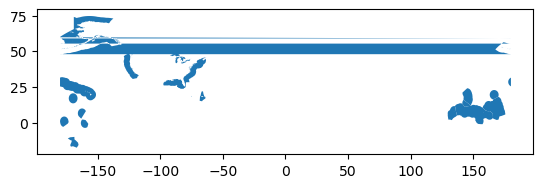

In [34]:
files = os.listdir('../data/RA Boundaries Shapefile/')

gdf_out = gpd.GeoDataFrame()

for file in files:
    if file.split('.')[-1] == 'shp':
        gdf = gpd.read_file('../data/RA Boundaries Shapefile/'+file)#, crs='WGS 84')
        gdf['RA'] = file.split('.')[0].split('_')[0]
        gdf = gdf.to_crs(crs='EPSG:4979')
        gdf_out = pd.concat([gdf_out, gdf])
    

gdf_out.plot()

In [35]:
gdf_out.explore()

In [36]:
gdf_out

,domain,Shape_Leng,Shape_Area,geometry,RA,Id,FID_1,objectid,scalerank,featurecla,...,water,sqmi,sqkm,GM_LAYER,NAME,LAYER,GM_TYPE,BNDTYPE,BNDNAME,Dummy
0,Alaska Ocean Observing System,7.268671e+07,3.718944e+12,"POLYGON ((-157.08322 74.70418, -157.02048 74.7...",AOOS,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,NaN,2.523617e+01,1.800285e+01,"POLYGON ((-66.66195 21.84095, -66.65406 21.840...",CARICOOS,0.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,1.352015e+00,1.256038e-01,"POLYGON ((-74.81189 18.42230, -74.81107 18.410...",CARICOOS,0.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,NaN,3.764055e+01,3.682109e+01,"POLYGON ((-124.20577 41.97632, -124.20368 41.9...",CeNCOOS,NaN,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,NaN,6.079592e+01,6.538212e+01,"POLYGON ((-80.37700 24.48368, -80.41000 24.471...",GCOOS,NaN,NaN,1.0,0.0,Ocean,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,NaN,1.790268e+02,2.817041e+01,"POLYGON ((-80.15334 42.58444, -80.15747 42.585...",GLOS,NaN,NaN,NaN,NaN,NaN,...,1.0,95910.0,248407.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,NaN,6.367171e+01,3.905642e+01,"MULTIPOLYGON (((-76.54411 35.23161, -76.56664 ...",MARACOOS,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,NaN,1.288557e+02,3.590104e+01,"POLYGON ((-124.00700 40.45530, -124.00670 40.4...",NANOOS,NaN,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,NaN,7.119408e+01,3.483234e+01,"POLYGON ((-71.87511 41.07571, -71.90330 41.084...",NERACOOS,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,NaN,2.857373e+01,3.403381e+01,"POLYGON ((-165.62222 -14.14928, -165.36861 -15...",PacIOOS,0.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,Unknown Line Type,American Samoa,Unknown Line Type,Unknown Line Type,EEZ,American Samoa,NaN


In [15]:
gdf_out.explore('RA')

In [17]:
gdf_out.to_file('ra_region_boundaries.geojson', driver="GeoJSON")  

AOOS is in NAD83 / Alaska Albers

Need to figure out a way to reproject to WGS84 and cross dateline.

<https://epsg.io/3338>

Cannot determine common CRS for concatenation inputs, got ['NAD83 / Alaska Albers', 'WGS 84']. Use `to_crs()` to transform geometries to the same CRS before merging.

<AxesSubplot: >

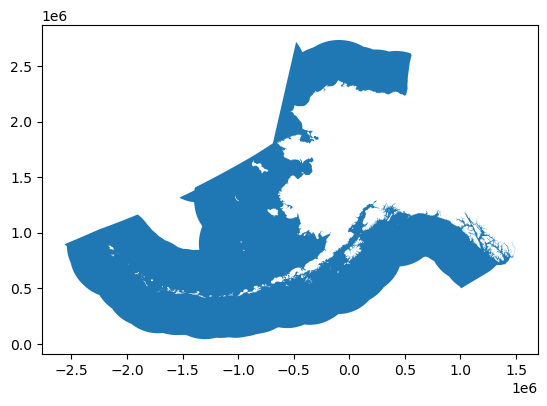

In [23]:
gdf = gpd.read_file('zip://../data/RA Boundaries Shapefile/RA_Boundaries_Shapefile.zip!AOOS.shp')

gdf.plot()

<AxesSubplot: >

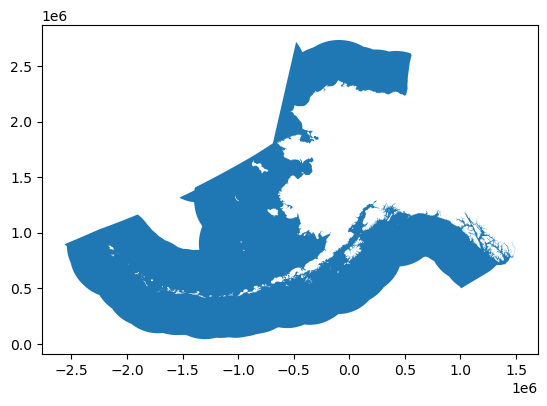

In [30]:
gdf.to_crs('EPSG:3338').plot()

In [ ]:
from typing import Union, List, Generator
from shapely.geometry import mapping, Polygon, GeometryCollection
from shapely import affinity

def check_crossing(lon1: float, lon2: float, validate: bool = False, dlon_threshold: float = 180.0):
    """
    Assuming a minimum travel distance between two provided longitude coordinates,
    checks if the 180th meridian (antimeridian) is crossed.
    """

    if validate and any([abs(x) > 180.0 for x in [lon1, lon2]]):
        raise ValueError("longitudes must be in degrees [-180.0, 180.0]")   
    return abs(lon2 - lon1) > dlon_threshold

def translate_polygons(geometry_collection: GeometryCollection, 
                       output_format: str = "geojson") -> Generator[
                          Union[List[dict], List[Polygon]], None, None
                       ]:
    
  for polygon in geometry_collection:
      (minx, _, maxx, _) = polygon.bounds
      if minx < -180: geo_polygon = affinity.translate(polygon, xoff = 360)
      elif maxx > 180: geo_polygon = affinity.translate(polygon, xoff = -360)
      else: geo_polygon = polygon

      yield_geojson = output_format == "geojson"
      yield json.dumps(mapping(geo_polygon)) if (yield_geojson) else geo_polygon

In [ ]:
import math
import copy
import json
from typing import Union, List
from shapely.geometry import Polygon, LineString, GeometryCollection
from shapely.ops import split

# https://gist.github.com/PawaritL/ec7136c0b718ca65db6df1c33fd1bb11
from geopolygon_utils import check_crossing, translate_polygons

def split_polygon(geojson: dict, output_format: str = "geojson", validate: bool = False) -> Union[
    List[dict], List[Polygon], GeometryCollection
    ]:
    """
    Given a GeoJSON representation of a Polygon, returns a collection of
    'antimeridian-safe' constituent polygons split at the 180th meridian, 
    ensuring compliance with GeoJSON standards (https://tools.ietf.org/html/rfc7946#section-3.1.9)
    Assumptions:
      - Any two consecutive points with over 180 degrees difference in
        longitude are assumed to cross the antimeridian
      - The polygon spans less than 360 degrees in longitude (i.e. does not wrap around the globe)
      - However, the polygon may cross the antimeridian on multiple occasions
    Parameters:
        geojson (dict): GeoJSON of input polygon to be split. For example:
                        {
                        "type": "Polygon",
                        "coordinates": [
                          [
                            [179.0, 0.0], [-179.0, 0.0], [-179.0, 1.0],
                            [179.0, 1.0], [179.0, 0.0]
                          ]
                        ]
                        }
        output_format (str): Available options: "geojson", "polygons", "geometrycollection"
                             If "geometrycollection" returns a Shapely GeometryCollection.
                             Otherwise, returns a list of either GeoJSONs or Shapely Polygons
        validate (bool): Checks if all longitudes are within [-180.0, 180.0]
      
    Returns:
        List[dict]/List[Polygon]/GeometryCollection: antimeridian-safe polygon(s)
    """
    output_format = output_format.replace("-", "").strip().lower()
    coords_shift = copy.deepcopy(geojson["coordinates"])
    shell_minx = shell_maxx = None
    split_meridians = set()
    splitter = None

    for ring_index, ring in enumerate(coords_shift):
        if len(ring) < 1: 
            continue
        else:
            ring_minx = ring_maxx = ring[0][0]
            crossings = 0

        for coord_index, (lon, _) in enumerate(ring[1:], start=1):
            lon_prev = ring[coord_index - 1][0] # [0] corresponds to longitude coordinate
            if check_crossing(lon, lon_prev, validate=validate):
                direction = math.copysign(1, lon - lon_prev)
                coords_shift[ring_index][coord_index][0] = lon - (direction * 360.0)
                crossings += 1

            x_shift = coords_shift[ring_index][coord_index][0]
            if x_shift < ring_minx: ring_minx = x_shift
            if x_shift > ring_maxx: ring_maxx = x_shift

        # Ensure that any holes remain contained within the (translated) outer shell
        if (ring_index == 0): # by GeoJSON definition, first ring is the outer shell
            shell_minx, shell_maxx = (ring_minx, ring_maxx)
        elif (ring_minx < shell_minx):
            ring_shift = [[x + 360, y] for (x, y) in coords_shift[ring_index]]
            coords_shift[ring_index] = ring_shift
            ring_minx, ring_maxx = (x + 360 for x in (ring_minx, ring_maxx))
        elif (ring_maxx > shell_maxx):
            ring_shift = [[x - 360, y] for (x, y) in coords_shift[ring_index]]
            coords_shift[ring_index] = ring_shift
            ring_minx, ring_maxx = (x - 360 for x in (ring_minx, ring_maxx))

        if crossings: # keep track of meridians to split on
            if ring_minx < -180: split_meridians.add(-180)
            if ring_maxx > 180: split_meridians.add(180)

    n_splits = len(split_meridians)
    if n_splits > 1:
        raise NotImplementedError(
            """Splitting a Polygon by multiple meridians (MultiLineString) 
               not supported by Shapely"""
        )
    elif n_splits == 1:
        split_lon = next(iter(split_meridians))
        meridian = [[split_lon, -90.0], [split_lon, 90.0]]
        splitter = LineString(meridian)

    shell, *holes = coords_shift if splitter else geojson["coordinates"]
    if splitter: split_polygons = split(Polygon(shell, holes), splitter)
    else: split_polygons = GeometryCollection([Polygon(shell, holes)])
        
    geo_polygons = list(translate_polygons(split_polygons, output_format))  
    if output_format == "geometrycollection": return GeometryCollection(geo_polygons)
    else: return geo_polygons

In [37]:
gdf['geometry']

0    POLYGON ((-71.50215 36.53583, -71.49663 36.516...
Name: geometry, dtype: geometry